<a href="https://colab.research.google.com/github/nhwzaan/multimedia_computing/blob/main/20520855_BT7_PCA_Image.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Thông tin sinh viên



- Họ tên: Nguyễn Thị Như Vân
- MSSV: 20520855

# Import thư viện

In [ ]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

In [ ]:
import math
import os
import time

In [ ]:
pip install Pillow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import librosa
import soundfile as sf

# PCA

In [ ]:
def ChoosingK(S):
  k=S.shape[0]+1
  variance_is_remained=1
  while variance_is_remained>=0.96:
    k-=1
    variance_is_remained=S[:k].sum(axis=0)/S.sum(axis=0)
  return k+1

## Encode

In [ ]:
def encodePCA(X):
  X = X.T
  M = X.shape[1]
  X_mean = X.mean(axis=1,keepdims=True)
  X_ = X-X_mean
  Sigma = np.dot(X_,X_.T)/M
  U, S, Vt = np.linalg.svd(Sigma, full_matrices=True)
  k = ChoosingK(S)
  U_k = U[:,:k]
  Z_k = np.dot(U_k.T,X_)
  return U_k, Z_k, X_mean, k

In [ ]:
def PCAwithoutChoosingk(X, k):
  X = X.T
  M = X.shape[1]
  X_mean = X.mean(axis=1,keepdims=True)
  X_ = X-X_mean
  Sigma = np.dot(X_,X_.T)/M
  U, S, Vt = np.linalg.svd(Sigma, full_matrices=True)
  #k = ChoosingK(S)
  U_k = U[:,:k]
  Z_k = np.dot(U_k.T,X_)
  return U_k, Z_k, X_mean, k


## Decode

In [ ]:
def decodePCA(U_k, Z_k, X_mean):
  return (U_k.dot(Z_k)+X_mean).T

# Nén ảnh với PCA

## Load ảnh mức xám

In [ ]:
! wget "https://i1-giaitri.vnecdn.net/2017/11/12/lee-sung-kyung-1.jpg?w=1200&h=0&q=100&dpr=1&fit=crop&s=kngh29WsMQXJPb0ATK4Cyg"

--2023-04-03 07:29:00--  https://i1-giaitri.vnecdn.net/2017/11/12/lee-sung-kyung-1.jpg?w=1200&h=0&q=100&dpr=1&fit=crop&s=kngh29WsMQXJPb0ATK4Cyg
Resolving i1-giaitri.vnecdn.net (i1-giaitri.vnecdn.net)... 111.65.251.12
Connecting to i1-giaitri.vnecdn.net (i1-giaitri.vnecdn.net)|111.65.251.12|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 407699 (398K) [image/jpeg]
Saving to: ‘lee-sung-kyung-1.jpg?w=1200&h=0&q=100&dpr=1&fit=crop&s=kngh29WsMQXJPb0ATK4Cyg.6’

lee-sung-kyung-1.jp 100%[===================>] 398.14K   432KB/s    in 0.9s    

2023-04-03 07:29:02 (432 KB/s) - ‘lee-sung-kyung-1.jpg?w=1200&h=0&q=100&dpr=1&fit=crop&s=kngh29WsMQXJPb0ATK4Cyg.6’ saved [407699/407699]



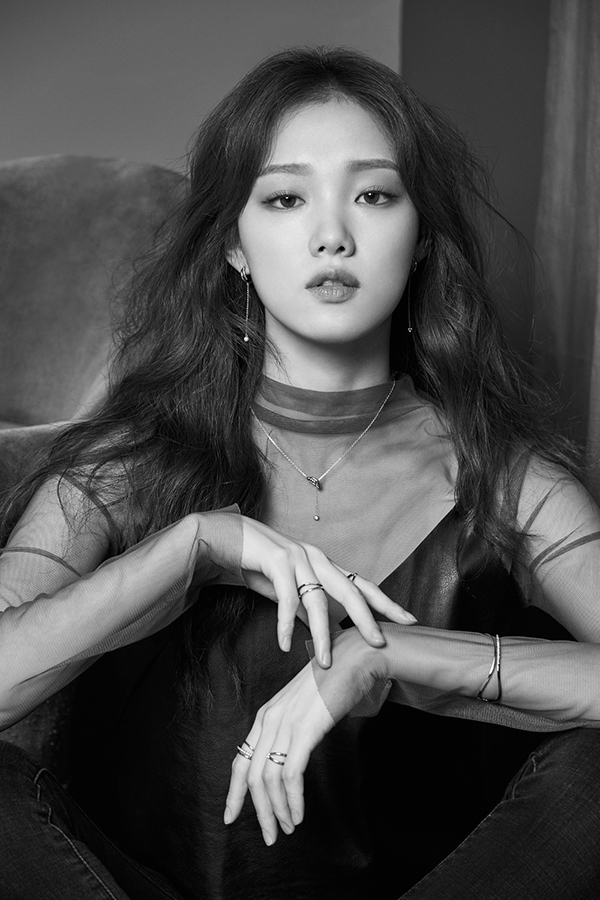

In [ ]:
img = cv.imread("/content/lee-sung-kyung-1.jpg?w=1200&h=0&q=100&dpr=1&fit=crop&s=kngh29WsMQXJPb0ATK4Cyg", cv.IMREAD_GRAYSCALE)
cv2_imshow(img)

## Test với mỗi k

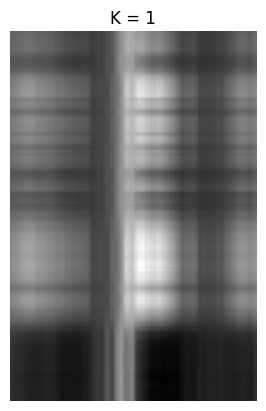

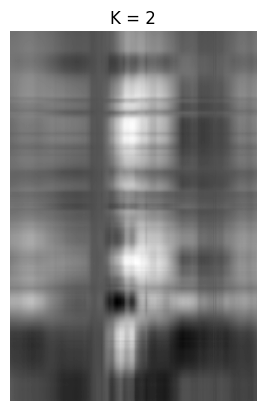

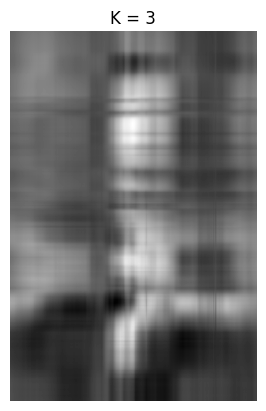

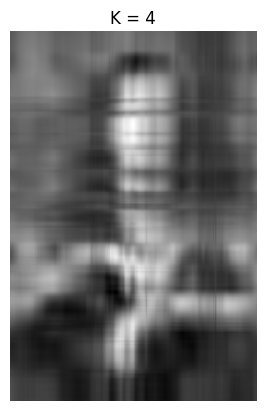

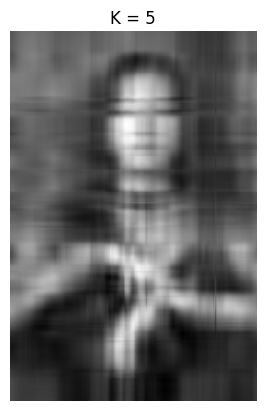

...

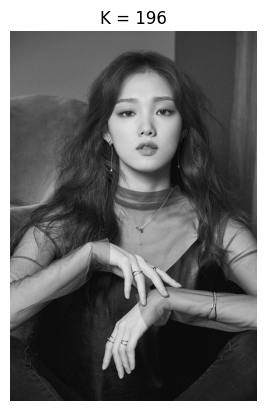

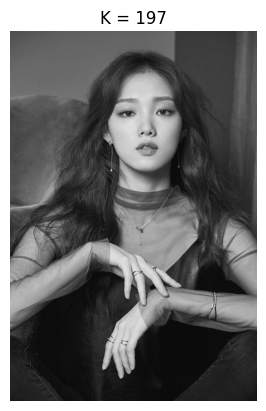

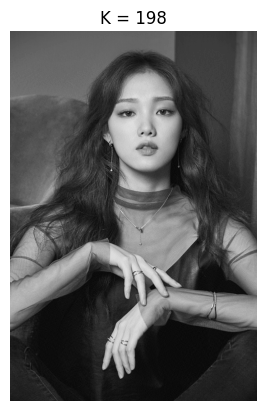

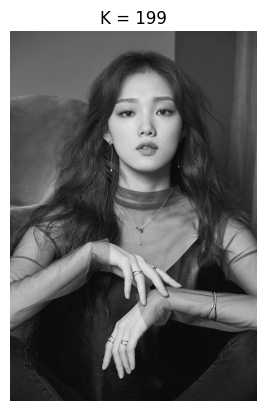

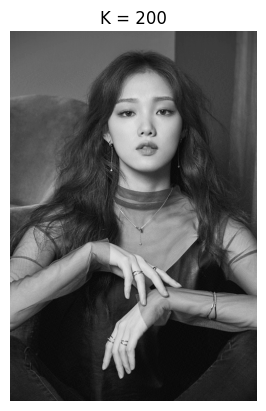

In [ ]:
for i in range(1, 201):
  U_k, Z_k, X_mean, _ = PCAwithoutChoosingk(img, k=i)
  decoded_img = decodePCA(U_k, Z_k, X_mean)
  plt.imshow(decoded_img, cmap="gray")
  plt.axis('off')
  plt.title("K = " + str(i))
  plt.show()

In [ ]:
U_k, Z_k, X_mean, k = encodePCA(img)

In [ ]:
print('Số thành phần chính được giữ lại là: ', k)

Số thành phần chính được giữ lại là:  26


In [ ]:
U_approx = decodePCA(U_k,Z_k,X_mean)

## Ảnh sau khi dùng PCA để nén và hồi phục

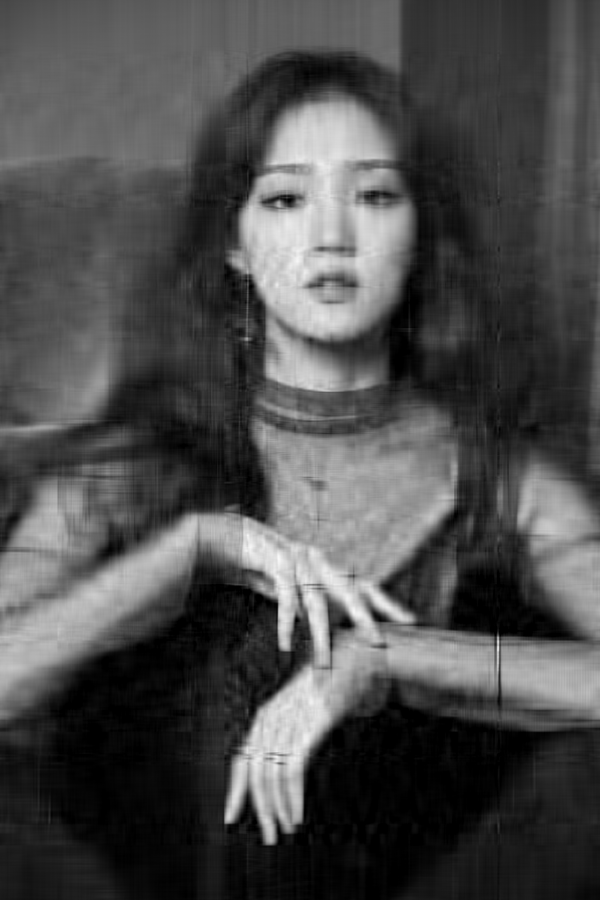

In [ ]:
cv2_imshow(U_approx)

## Tính toán lượng thông tin được giữ lại

In [ ]:
def calculateRk(X, K):
  X = X.T
  M = X.shape[1]
  X_mean = X.mean(axis=1,keepdims=True)
  X_ = X-X_mean
  Sigma = np.dot(X_,X_.T)/M
  _, S, _ = np.linalg.svd(Sigma, full_matrices=True)

  return S[:K].sum(axis=0)/S.sum(axis=0)

In [ ]:
calculateRk(img, 26)

0.9612775307602734